Photography is one of my hobbies and a good percentage of my photography workflow is spent on correcting various artifacts in images. I always wondered if there is I could efficiently automate the process of image correction/restoration but I didn't pay much attention to image restoration using deep learning. So, for the past couple of months I started playing around with different techniques in the image restoration side of deep learning in the hopes of creating a tool that would assist me in image restoration part of my photography workflow and whatever I have learnt till now, I am putting into a series of articles. 

This is first in a series of such articles where we will try to build a image correction tool by implementing some cool generative imaging techniques using [Fastai](https://docs.fast.ai/) and pytorch. Infact this entire series is inspired by the [fastai course from the year 2018](https://github.com/sapal6/course-v3/blob/master/nbs/dl1/lesson7-superres.ipynb).

::: {.callout-note appearance="minimal" icon=false}

## 📒 Side Note
Fastai is a deep learning library built on top of pytorch. Fastai provides powerful APIs to create a wide range of deep learning architectures and it's layered API makes it easy to implement new architectures as well.

:::

At the end of the article I will also post links to different resources from which I got to know a lot about GANs and related techniques.

At the begining of this notebook we will install all the required packages.

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
try: import fastkaggle
except ModuleNotFoundError:
    !pip install -Uq fastkaggle

In [ ]:
try: import fastai
except ModuleNotFoundError:
    !pip install -Uq fastai

In [ ]:
# install fastkaggle if not available
try: import fastaibreadcrumbs
except ModuleNotFoundError:
    !pip install -Uq fastaibreadcrumbs

Then we will import the required modules.

In [ ]:
import gc
from fastai.vision.all import *
from fastai.vision.gan import *
from fastkaggle import *
from fastaibreadcrumbs.core import *

### Image restoration
Simply put Image restoration is the task of correcting imperfections in images. For example, you have taken some photographs of your pet and the photo, although it's good but suffers from camera shake. Wouldn't it be nice if you could remove some of the camera shake from the image so that you don't have to discard the image altogether? 

In this article we would try to achieve just that using deep learning.

### Pre-requisites
This article and the other upcoming articles in this series needs some basic understanding of deep learning. I would recommend you to go through the ["Practical Deep Learning"](https://course.fast.ai/) course to get an understanding about deep learning.


### Getting the data
I would need training data for my task but it so happens that my task is an unique one and I would need to collect my own data. One way collect data is to create them. 

To create data I would need to collect some images first and then artificially introduce shakes and blurs into these images and to do this we will write some code to "crappify" data. 

> I heard this term "crappify" and this technique of creating "bad" data in [lesson-7 of Fastai's 2019 course](https://youtu.be/9spwoDYwW_I). 

I have created a [dataset](https://www.kaggle.com/datasets/sapal6/superresolution) of high resolution images that I collected from the free stock photography website [pexels.com](https://www.pexels.com/). During the training cycle of my model I combined my data with another [dataset](https://www.kaggle.com/datasets/thaihoa1476050/df2k-ost) which also had some more high resolution images.

## Downloading the data

I have created a tiny library ["fastaibreadcrumbs"](https://sapal6.github.io/fastaibreadcrumbs/). It provides some convinience functions that extends a few of the functionalities available in the ["fastkaggle"](https://fastai.github.io/fastkaggle/) library.

"fastaibreadcrumbs" provides a `setup_data` using which you can pull any kaggle non-competition dataset onto your machine. Just provide the username from the kaggle dataset page and the dataset name.

::: {.callout-note}

## Note

If you are trying to pull a competition dataset then fastkaggle has an equivalent function `setup_comp`.

::: 

We will pull the first dataset (the one I collected from pexels.com)

In [ ]:
path1 = setup_data('sapal6', 'superresolution')

In [ ]:
path1.ls()

(#11) [Path('superresolution/trains'),Path('superresolution/nature'),Path('superresolution/kids-playing'),Path('superresolution/fireworks'),Path('superresolution/busystreet'),Path('superresolution/dogs-running'),Path('superresolution/sports'),Path('superresolution/underwater'),Path('superresolution/dance'),Path('superresolution/wildlife')...]

Then we will pull the other dataset from kaggle which I will combine with my dataset. 

> Sometimes more data helps. While experimenting for this tutorial, I found that the amount of data that I had in my dataset was not enough and adding a few more samples expanded the variation in the input. That's why I augmented my dataset with some external data (which in this case was another dataset from kaggle). 

:::{.callout-tip}

If your model's results are not at par then you should first try to bring in more training data (if it's possible because in many domains more data is simply hard to come by). If addign more data doesn't improve your model then you should look to other techniques.

:::

In [ ]:
path2 = setup_data('thaihoa1476050', 'df2k-ost')

In [ ]:
path2.ls()

(#2) [Path('df2k-ost/train'),Path('df2k-ost/test')]

The next thing that I am going to do is to create a config sort of thing that would help me to store frequently used values.

:::{.callout-tip}
In real world a better way is to create a config file in your project.
:::

In [ ]:
config = {'root':Path(".")}

## Crappifying
In order to get the target images which in our case are the images having "camera shake" in them, we need to simulate motion blur. "fastaibreadcrumbs" provides `Crappifier` which takes in images and creates another version of the same image that has motion blur in it.

First let's get the source and destination paths.

In [ ]:
config['path_hr1'] = path1
config['path_hr2'] = path2

In [ ]:
config['path_crappy'] = Path('crappy')

fastai provides `get_image_files` which fetches all teh image files from a given path. We will use this get the images from our first dataset.

In [ ]:
files_hr1 = get_image_files(config['path_hr1'])

In [ ]:
files_hr1[:10]

(#10) [Path('superresolution/trains/0055.jpg'),Path('superresolution/trains/0002.jpg'),Path('superresolution/trains/0067.jpg'),Path('superresolution/trains/0022.jpg'),Path('superresolution/trains/0012.jpg'),Path('superresolution/trains/0019.jpg'),Path('superresolution/trains/0009.jpg'),Path('superresolution/trains/0051.jpg'),Path('superresolution/trains/0047.jpg'),Path('superresolution/trains/0072.jpg')]

similarly we will get the images from teh second dataset path.

In [ ]:
files_hr2 = get_image_files(config['path_hr2'])

Let's crappify a single image to check if things work.

In [ ]:
Crappifier(config["path_crappy"])(files_hr1[0])

Let's grab our crappified image.

In [ ]:
files_crappy1 = get_image_files(config['path_crappy'])

In [ ]:
files_crappy1[0]

Path('crappy/path_860/trains/0055.jpg')

"fastaibreadcrumbs" provides the convinience function `show_plot` which let's you display two images side by side.

::: {.callout-note}

If you look into the source code of `show_plot` it's only a few lines of code. Under the hood it's only matplotlib functions. So, if you don't want to use `show_plot` then you can create your own plotting function.

:::

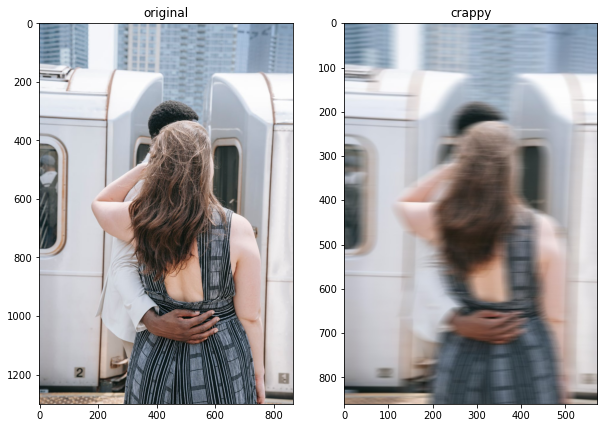

In [ ]:
show_plot(files_hr1[0], files_crappy1[0], 1, (10, 10))

In [ ]:
#cleaning up the crappy directory.
shutil.rmtree(config['path_crappy'])

While feeding data into a neural network, all teh images needs to be in same size. So, let's first check the sizes of our training images.

There is a neat trick which I learned from [Jeremy Howard's notebook](https://www.kaggle.com/code/jhoward/first-steps-road-to-the-top-part-1) to get the image size. I am using the same code here.

In [ ]:
from fastcore.parallel import *

In [ ]:
def f(o): return PILImage.create(o).size
sizes = parallel(f, files_hr1+files_hr2, n_workers=4)
pd.Series(sizes).value_counts()

/usr/local/lib/python3.9/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/PIL/Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


(1880, 1253)    4147
(867, 1300)     2608
(2040, 1356)    1435
(496, 368)       637
(1733, 1300)     623
                ... 
(464, 416)         1
(1803, 1300)       1
(1756, 1300)       1
(1235, 1300)       1
(2040, 1740)       1
Length: 2790, dtype: int64

Now, there are a variety of image sizes and orientations but most of the images have there sizes in the range of a minimum of 800ish(shortest side) and 1300is(longest side). So, I will randomly pick a proportion which allows me to resize an image having teh longest side as 860. I could also have picked up a higher size but then the compute required would have been higher.

Fastai can resize images while loading data but all those computation would take time and the training speed might get affected on low power devices (for example my laptop which has a humble gpu). We may end up resizing the images to still lower sizes during the creation of dataloader but an initial resizing really helps to save some computing during the training time. 

> These resizing tricks to save computing and speeding up training is what I got to know from [Jeremy Howard's notebook](https://www.kaggle.com/code/jhoward/first-steps-road-to-the-top-part-1) and from my own experiments that I did on my local machine and my experiments done on kaggle kernel. Your experience might vary depending upon the computing power that you have access to. So, again feel free to experiment.

I will create a config for the path where I am goign to store my resized images.

In [ ]:
config['path_860'] = Path('path_860')

fastai provides `resize_images` which resizes your source images to the desired size. The below function `resz_imgs` is just a wrapper on top of fastai's `resize_images`. Pass on the source and destination paths and pass the maximum size that you want your images to be resized to. `resize_images` will then resize the images to the new proportions while keeping the longest side to the given `max_sz` and accordingly modify the shortest side.

In [ ]:
def resz_imgs(source: Path, dest: Path, max_sz: int):
    resize_images(source, dest=dest, max_size=max_sz, recurse=True)

Let's resize the first dataset.

In [ ]:
#for first set
resz_imgs(config['path_hr1'], config['path_860'], max_sz=860)

Then the second dataset.

In [ ]:
#for second set
resz_imgs(config['path_hr2'], config['path_860'], max_sz=860)

Next, we are going to crappify our resized images and we are going to do that in parallel. Do do things in parallel we will use `parallel` provided by [fastcore](https://fastcore.fast.ai/). It's similar to python standard library's parallel function but much more convenient.

::: {.callout-note appearance="minimal" icon=false}

## 📒 Side Note

fastcore is a underrated python library which supercharges python.

:::

For parallel crappification, I will use `crappify_imgs` provided by "fastaibreadcrumbs" which let's you provide the high resolution image path and the destination path, strength of the blur (as `sz`).

In [ ]:
crappify_imgs(config['path_860'], config['path_crappy'], n_workers=8)

## Grabbing the data
Now that crappification is done, let's grab our input and target data. We can do this by using fastai `Datablock` API. `Datablock` let's you customize the way you want to grab your input and output.

In [ ]:
files_crappy = get_image_files(config['path_crappy'])
files_crappy[:4]

(#4) [Path('crappy/path_860/trains/0055.jpg'),Path('crappy/path_860/trains/0002.jpg'),Path('crappy/path_860/trains/0067.jpg'),Path('crappy/path_860/trains/0022.jpg')]

In [ ]:
files_crappy[0].relative_to(config['path_crappy'])

Path('path_860/trains/0055.jpg')

In [ ]:
dblock = DataBlock(blocks=(ImageBlock, ImageBlock),
                       get_y = lambda x: x.relative_to(config['path_crappy']),
                       splitter=RandomSplitter(),
                       item_tfms=Resize(480),
                       batch_tfms=[*aug_transforms(max_zoom=2.), Normalize.from_stats(*imagenet_stats)])

In the first line we describe outr `blocks` which are the x and y. Here, our x and y both are images and thus we provide `Imageblock` as the blocks of choice. Then we use lambda function to tell fastai that we are expecting the crappy images as our y, whose filename match with the filename of the input images. After defining our labels (y) we tell fastai to randomly split our images into training and test data. Then we call the `Resize` since we want all our images to be of same size. Lastly we do some augmentations.

In [ ]:
dls = dblock.dataloaders(files_crappy, bs=4)

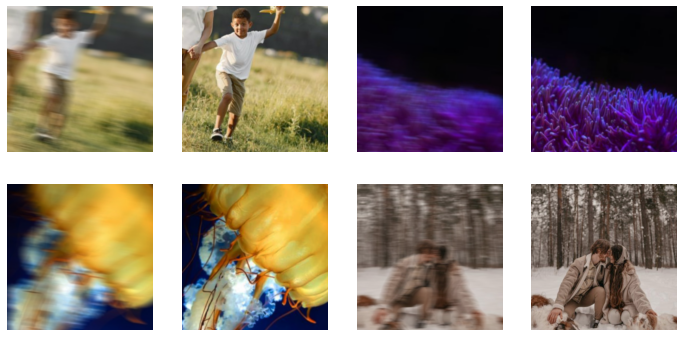

In [ ]:
dls.show_batch()

### Feature loss
In the paper ["Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/abs/1603.08155) the authors proposed a kind of loss known as perceptual loss which would compare different feature maps of the target image with the feature map of the generated image to see if teh generated image's features are the same as the actual image. This can otherwise be known as "feature loss" as described in the [Fastai course 2019 lesson 7](https://youtu.be/9spwoDYwW_I).

The below doodle gives a very simple overview of the method used by the authors of the ["Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/abs/1603.08155) paper

<p align="center">
  <img src="featureloss.png"/>
</p>

In the proposed method, the hourglass shaped figure is a pre-cursor to "Unet" which is made up  of a encoder for learning the features of an input image and a decoder which would reconstruct the image while upscaling the image. 

> This is similar to super-resolution where an U-net is used to scale up the resolution of an image. Such a network can also be used for tasks like improving the quality of a crappy image.

The colorful rectangle in the above figure is a pre-trained image model like vgg-16 which feeds on teh image generated by the U-net. While the generated image passes through the pre-trained image model, the feature map of the generated images are grabbed from the intermidiate layers of the vgg-16 model. The target image (actual data) is alos passed through this vgg-16 model it's feature map is also extracted from teh intermidiate layers. After this is done, the feature map of the generated image is compared with the feature map of the target image. This is done by the feature loss function which is then used to re-train the U-net in order to make the generated model appear as close as possible to the actual thing.

## Extracting features
If recall the diagram from previous section, you will notice that we need to extract the features from our input image as well as the target image which we can compare later. To extract the features, we will use a simple pre-trained network like "vgg16".

This below is a representation of the pre-trained network which we would be using to extract the features from our images. The sections in this image represents different layers of the network and the downward arrows represent the extraction of the features. 

<p align="center">
  <img src="featuremap.png"/>
</p>

The features are grabbed just before the grid size changes and the maxpooling layer in network is where the grid size change occurs.

## Feature Loss
Taking all the previous things into account, we will use a pre-trained vgg16 to create a loss function that will help the network to compare the pixels of the target and the input image and check if the two images are the same. 

"fastaibreadcrumbs" provides `calc_ft_loss` which does the heavy lifting of initiating a vgg16 pre-trained model and calculating the feature loss for you.

> If you wan to know more about what happens under the hood then I feel free to read through the [fastai course(2018) notebook here](https://github.com/sapal6/course-v3/blob/master/nbs/dl1/lesson7-superres.ipynb) and watch the lecture [here](https://youtu.be/9spwoDYwW_I)

In [ ]:
feat_loss = calc_ft_loss()

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and will be removed in 0.15. Please use keyword parameter(s) instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

## Grabbing data
Like before we have to create a dataloader which would load adata onto the device. We can use fastai's dataloader for this purpose but for convenience I will use the `get_unet_dls` from "fastaibreadcrumbs" which is simply a wrapper over a fastai datablock with two Imageblocks (one Imageblock for input and one Imageblock for target) and a dataloader.

In [ ]:
config

{'root': Path('.'),
 'path_hr1': Path('superresolution'),
 'path_hr2': Path('df2k-ost'),
 'path_crappy': Path('crappy'),
 'path_860': Path('path_860')}

...setting some parameters like weight decay, nymber of epochs etc...

In [ ]:
# hyperparameters
config['epoch'] = 4
config['wd'] = 1e-3

...then we will set our item transformations. These are the transformations which will be applied to each item when they are loaded. Here, we will reduce the size of images to a smaller size. We will use `Resize` for this. Then we will setup our "batch transformations", these are the transformations which will be applied to the images once they are grouped into batches. In our case we will apply image augmentations to our batches which will do things like rotate the images, brighten up the images, darken the images, flip the images etc. After that we will setup the method by the way of which we want to grab our target images. Here, we will use a path relative to our crappy images because the directory structure and the image name of the crappy images matches with that of our input images.

> Training on a smaller image size will make our training faster and this will enabel use to iterate faster in case we want to try a lots of things to find the best settings fro our training. There is one more reason due to which we may want to start with a smaller image size. We are going to use something known as "progressive resizing" , whereby we start training with small images and then use the model trained on these smaller images as a pre-trained model for another training setup where we use slightly bigger images. This makes the trainign a lot faster then starting with big images from the get go. Remember that our goal is to make our training as fast as possible.

In [ ]:
#transformations
item_tfms = Resize(128)
batch_tfms = [*aug_transforms(max_zoom=2.), Normalize.from_stats(*imagenet_stats)]
get_y = lambda x: x.relative_to(config['path_crappy'])

After all these are done, we will pass the following to the `get_unet_dls` function -->

* batch size
* source i.e. the crappy file names
* `get_y` i.e. the way to fetch our targets
* `splitter` i.e. how to split our data into trainign and validation sets.
* item_tfms i.e. item transformations.
* `batch_tfms` i.e. batch transformations.

In [ ]:
dls= get_unet_dls(8, source = files_crappy, get_y = get_y, 
                     splitter = RandomSplitter(), item_tfms = item_tfms,
                     batch_tfms = batch_tfms)

let's see our samples.

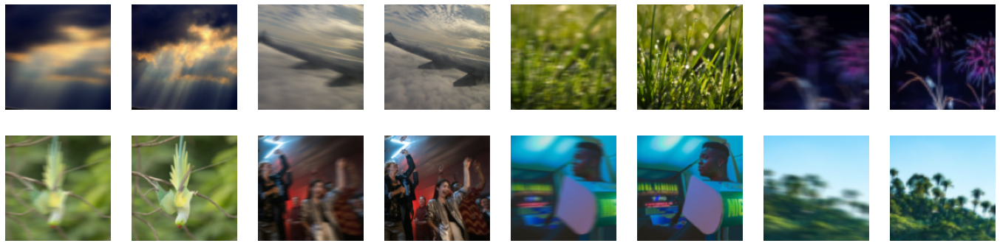

In [ ]:
dls.show_batch()

## Unet
Now that we have our feature loss and data ready, let's create a unet.

Creating a basic unet is a one liner affair in fastai. Ofcourse, you can do all sorts of customization to your unet but I will use the minimalist way here and take advantage of the high level API in fastai.

We will use the unet_learner parameters recommended [here](https://github.com/sapal6/course-v3/blob/master/nbs/dl1/lesson7-superres.ipynb).

In [ ]:
unet_learn = unet_learner(dls, models.resnet34, loss_func=feat_loss,
                          metrics=LossMetrics(feat_loss.metric_names),
                          blur=True, norm_type=NormType.Weight)

gc.collect();

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

Notice that I have passed something like `LossMetrics(feat_loss.metric_names)` to the unet. This is our metric which will tell us how our unet is progressing. Where does this comes from?

Well if you look into the source code of the `Feature_loss`-

```
class FeatureLoss(Module):
    """Class to calculate feature loss"""
    def __init__(self, m_feat, layer_ids, layer_wgts):
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target, reduction='mean'):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [pixel_loss(input,target,reduction=reduction)]
        self.feat_losses += [pixel_loss(f_in, f_out,reduction=reduction)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [pixel_loss(gram_matrix(f_in), gram_matrix(f_out),reduction=reduction)*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        if reduction=='none': 
            self.feat_losses = [f.mean(dim=[1,2,3]) for f in self.feat_losses[:4]] + [f.mean(dim=[1,2]) for f in self.feat_losses[4:]]
        for n,l in zip(self.metric_names, self.feat_losses): setattr(self, n, l)
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()
```

...notice that we have something called `metric_names` there. This thing is the collection of the pixel loss and gram loss which can then be used as a metric by us.

fastai provides the `lr_find` function which we will use to find a suitable learning rate.

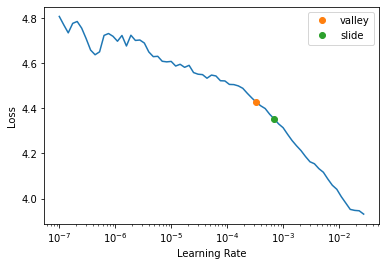

In [ ]:
lr = unet_learn.lr_find(suggest_funcs=(valley, slide))

`lr_find` has a few different methods of finding the learning rate but the "valley" and "slide" functions provide suitable learning rate most of the time. 

The `lr_find` suggests very optimistic values of learning rates so that we don't screw up our training but another thing that we can do is to look at the learning rate suggested by the "valley" and "slide" functions and then take a value in between these two.

In [ ]:
(lr.valley, lr.slide)

(0.0003311311302240938, 0.0006918309954926372)

We will train the unet using the "one cycle policy". From 50,000 feet, the one cycle policy can be explained like this "A one cycle policy trains the model with large and oscillating (changing between different values) learning rate in order to make the training faster and more accurate". A more detailed explanation can be found in this cool [article](https://iconof.com/1cycle-learning-rate-policy/).

There is one more trick that I am going to use in my unet_learner. I have experimented with quite a different versions of this notebook with variety of data (variations both in nterms of number of images and amount of data) and I have found that with data variations it becomes difficult for me to predict that a particular choice of "epoch numbers" will work everytime. So, I will need to tell fastai that when we need to stop training if my loss is not improving and save my modell whenever a "good" enough loss state is reached. This can be done by the [`EarlyStoppingCallback`](https://docs.fast.ai/callback.tracker.html) and [`SaveModelCallback`](https://docs.fast.ai/callback.tracker.html#savemodelcallback). The former stops the model trainign if the loss doesn't improve further and the latter will save the best possible model. I have provided links to the official documentation of these two functions if you wan tot know more about them.

But hey! what's a callback? Simply put a callback is a function that is passed as an argument to another function. It provides a way for the programmer to modify an existing piece of code without changing the structure of code. With callbacks you can modify the behaviour of your piece of code, say a function without changing the body of your current function. [Here](https://pythonexamples.org/python-callback-function/) is an article that explains callbacks with examples.

In [ ]:
unet_learn.fit_one_cycle(config['epoch'], (lr.valley+lr.slide)/2, pct_start=0.9, wd=config['wd'], 
                         cbs=[EarlyStoppingCallback(patience=2), SaveModelCallback(fname='model_128')])

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2,time
0,2.209806,2.456991,0.185003,0.207987,0.262833,0.114802,0.530690,0.872372,0.283306,06:00
1,2.042598,2.254473,0.171976,0.196098,0.245231,0.106519,0.463559,0.806346,0.264745,06:03
2,1.886767,2.064314,0.150376,0.181493,0.225683,0.098219,0.433128,0.729233,0.246182,06:01
3,1.694850,1.856245,0.135413,0.170341,0.208545,0.090624,0.365436,0.657052,0.228834,06:04


Better model found at epoch 0 with valid_loss value: 2.45699143409729.
Better model found at epoch 1 with valid_loss value: 2.2544734477996826.
Better model found at epoch 2 with valid_loss value: 2.0643138885498047.
Better model found at epoch 3 with valid_loss value: 1.8562445640563965.


we can view the predictions on the validation set using `show_results`

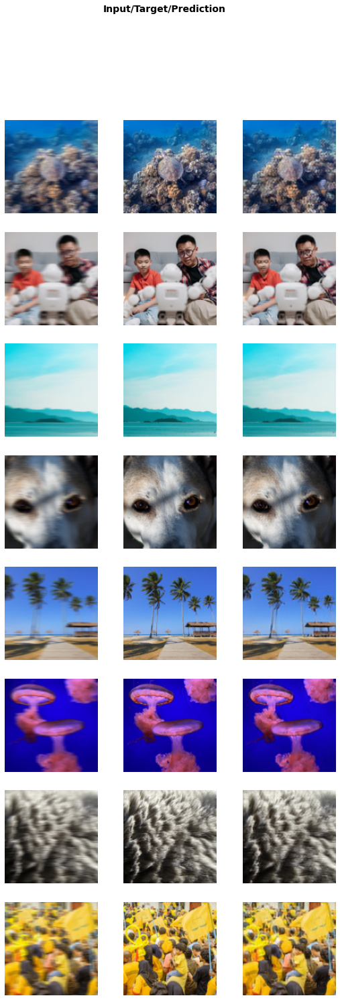

In [ ]:
unet_learn.show_results()

## Progressive resizing
Even with an image size of 128px our model is doing a good job of removing the motion blur and generating the blur free images. Now, let's use this model as a pre-trained model fro our next training phase where we will increase the image size to 256px. 

In [ ]:
#transformations
item_tfms = Resize(256)
batch_tfms = [*aug_transforms(max_zoom=2.), Normalize.from_stats(*imagenet_stats)]
get_y = lambda x: x.relative_to(config['path_crappy'])

In [ ]:
dls= get_unet_dls(8, source = files_crappy, get_y = get_y, 
                     splitter = RandomSplitter(), item_tfms = item_tfms,
                     batch_tfms = batch_tfms)

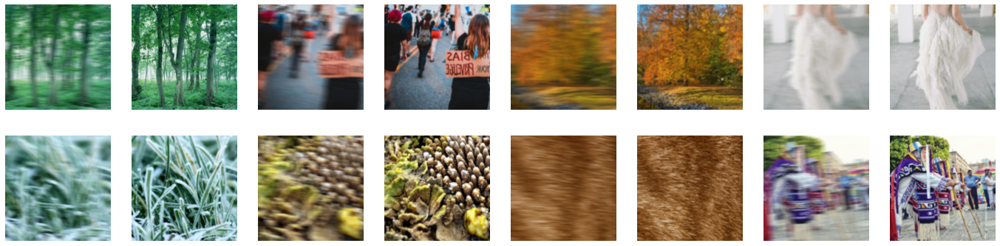

In [ ]:
dls.show_batch()

since we have re-initialized our unet_learner, we would need to assign the new dataloader (the one with 256px images) to the learner.

In [ ]:
unet_learn.dls = dls

Load the model that was trained on the 128px images.

In [ ]:
unet_learn.load('model_128');

/usr/local/lib/python3.9/dist-packages/fastai/learner.py:58: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


Remember that our input image size have changed now and so has the parameters of our model. Due to this we will have to find new learning rate.

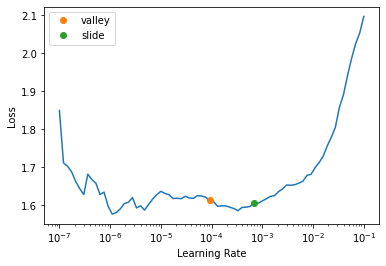

In [ ]:
lr = unet_learn.lr_find(suggest_funcs=(valley, slide))

In [ ]:
(lr.valley, lr.slide)

(9.120108734350652e-05, 0.0006918309954926372)

Next, we will fine tune our model on the new set of data. With `fine_tune` we ask fastai to freeze the model, train it for a epoch, unfreeze it and then train for some more epochs. 

In case you wan to understand more about `fine_tune`, then here is the [source code](https://github.com/fastai/fastai/blob/f2ab8ba78b63b2f4ebd64ea440b9886a2b9e7b6f/fastai/callback/schedule.py#L153) and [here](https://github.com/fastai/fastai/blob/f2ab8ba78b63b2f4ebd64ea440b9886a2b9e7b6f/fastai/callback/schedule.py#L153) is an old thread in the fastai forum where `fine_tune` was discussed.

In [ ]:
unet_learn.fine_tune(5, (lr.valley+lr.slide)/2, pct_start=0.9, wd=config['wd'], 
                         cbs=[EarlyStoppingCallback(patience=2), SaveModelCallback(fname='model_256')])

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2,time
0,1.473990,1.519641,0.186348,0.215888,0.219089,0.080457,0.296886,0.394380,0.126594,16:53


Better model found at epoch 0 with valid_loss value: 1.519641399383545.


epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2,time
0,1.412022,1.459381,0.178994,0.212948,0.214645,0.078533,0.275205,0.375495,0.123562,17:30
1,1.368803,1.436245,0.174595,0.210241,0.212634,0.077483,0.268589,0.370479,0.122224,17:30
2,1.368343,1.437706,0.169373,0.206416,0.211114,0.077285,0.278587,0.373089,0.121841,17:31
3,1.324890,1.393757,0.164672,0.203151,0.207758,0.075826,0.261442,0.361697,0.119211,17:30
4,1.313353,1.355986,0.158461,0.200111,0.204974,0.074636,0.248391,0.351761,0.117653,17:30


Better model found at epoch 0 with valid_loss value: 1.4593812227249146.
Better model found at epoch 1 with valid_loss value: 1.4362448453903198.
Better model found at epoch 3 with valid_loss value: 1.393756628036499.
Better model found at epoch 4 with valid_loss value: 1.3559863567352295.


Let's check the predictions on the validation set.

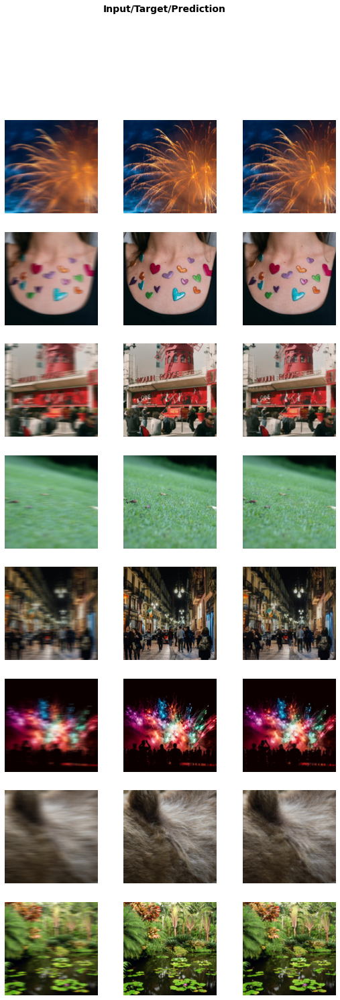

In [ ]:
unet_learn.show_results()

So, the results here have improved as compared to the 128px images. You see that's how progressive resizing helps. Starting with smaller sized images makes training faster.

From this point onwards you can keep on increasing the image size and keep training until the performance of your model doesn't improve much.

## Observations from my experiments

I have actually done many different experiments on this and I have the followign observations -->

* When sufficient data is available, training for a 4-5 epochs during each stage of progressive re-sizing is sufficient to generate "decently blur free" images.

* I have got decent results during training done on only 200 images but there were some noticeable artifacts in the generated images. An interesting thing I noticed was that the motion blur was removed.

* In my experiments even when I didn't continue the training after I had trained the model on 256px images, decent results were produced on bigger sized images during inference.

## Inference
Let's test our model on unseen data. For this I have downloaded new images (which were not inlcuded in teh training data) from pexels.com.

In [ ]:
config['test_860'] = Path("test_860")
config['test_crappy'] = Path("test_crappy")

In [ ]:
files_test = get_image_files(config['test_860'])

In [ ]:
files_test

(#2) [Path('test_860/sports/pexels-pixabay-248547.jpg'),Path('test_860/signpost/signpost.jpg')]

...and crappified them like before.

In [ ]:
crappify_imgs(config['test_860'], config['test_crappy'], sz=80, n_workers=8)

In [ ]:
files_crappy = get_image_files(config['test_crappy'])

We also need to grab our dataloader with the same type of transformations as before but this time we will take a 860px image because we are trying to generate "full size" blur free image.

In [ ]:
#transformations
item_tfms = Resize(860)
batch_tfms = [*aug_transforms(max_zoom=2.), Normalize.from_stats(*imagenet_stats)]
get_y = lambda x: x.relative_to(config['test_crappy'])

In [ ]:
dls= get_unet_dls(2, source = files_crappy, get_y = get_y, 
                     splitter = RandomSplitter(), item_tfms = item_tfms,
                     batch_tfms = batch_tfms)

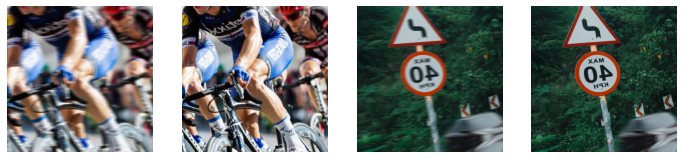

In [ ]:
dls.show_batch()

Create the Unet learner as before.

In [ ]:
unet_learn = unet_learner(dls, models.resnet34, loss_func=F.l1_loss,
                     blur=True, norm_type=NormType.Weight).load(config['root']/'model_256')

Before prediction we will drop any sort of augmentation from our data.

In [ ]:
dl = dls.train.new(shuffle=False, drop_last=False, 
                       after_batch=[IntToFloatTensor, Normalize.from_stats(*imagenet_stats)])

"fastaibreadcrumbs" provides `save_preds`, to which we pass the dataloader, learner and the path. This function will generate the predictionsa nd save them.

In [ ]:
save_preds(dl, unet_learn, "gen_imgs")

In [ ]:
preds = [Path("gen_imgs")/fn.name for fn in files_crappy]

"fastaibreadcrumbs" provides `compare_imgs` which takes in the path of the original images, path of crappy images, path of generated images and then compare them side by side.

[[<AxesSubplot:> <AxesSubplot:> <AxesSubplot:>]
 [<AxesSubplot:> <AxesSubplot:> <AxesSubplot:>]]


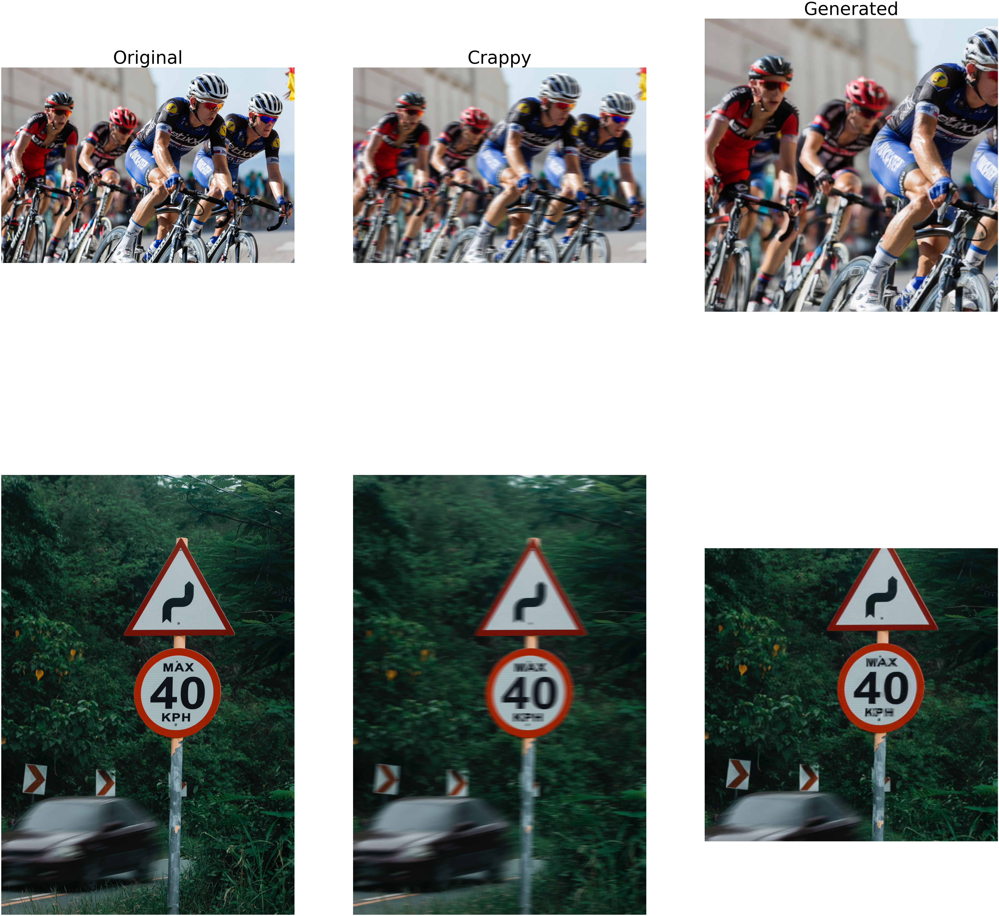

In [ ]:
compare_imgs(files_test, files_crappy, preds, (100, 100))

## Conclusion

Look! With a few epochs of training our model was able to recognize and remove motion blur from images. This is incredible as to how with some clever tricks (like progressive resizing) we can create such powerful deep learning models which runs fast on quite decent machines and with "not so crazy" amount of data. Another thing to note is that we had just used 256px images in our training but even then our model generalizes quite well when a bigger image is given to it. So, a couple of more epochswould produce even better results.

One quick thing to note is that you might notice the proportion difference between the original image and the generated images. This is becasue we had resized the images to 860px during training to make the inference faster. If you have access to GPUs with larger memory, then you can give the full size image a shot.

Now that we have created and trained a model to remove camera shake from our images, in next chapter we will prototype a Graphical tool that can be used as an interface to consume this model.

## Reading list
* [Code for this tutorial](https://github.com/sapal6/image-restoration)
* Superresolution- Fastai - [Lesson Notebook](https://github.com/fastai/fastai/blob/master/dev_nbs/course/lesson7-superres.ipynb), [Lesson video](https://www.youtube.com/watch?v=9spwoDYwW_I&t=4243s)

* [Fastai course 2022](https://course.fast.ai/)

* ["Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/abs/1603.08155)

* [Walk with fastai](https://walkwithfastai.com/Super_Resolution)